In [1]:
import geopandas as gpd
import folium
import matplotlib.pyplot as plt

In [2]:
# generate map data dataframe
df = gpd.read_file('md_map_data.geojson')
df.head()

,COUNTY,DISTRICT,TSD_ID,OBJECTID_1,COUNTY_FIP,COUNTYNUM,ShapeSTArea,ShapeSTLength,geometry
0,Garrett,6,4,1,23,11,2.865888e+09,269160.906618,"POLYGON ((-78.92842 39.72277, -79.47676 39.721..."
1,Washington,6,1060,2,43,21,2.041340e+09,375108.707731,"POLYGON ((-78.33777 39.72256, -78.33780 39.722..."
2,Dorchester,1,5,3,19,9,4.162348e+09,321145.407961,"POLYGON ((-75.71224 38.64172, -75.71230 38.641..."
3,Worcester,1,2,4,47,23,2.456936e+09,269799.871561,"POLYGON ((-75.06149 38.39055, -75.06125 38.391..."
4,Frederick,7,24,5,21,10,2.905713e+09,270091.287672,"POLYGON ((-77.35263 39.71988, -77.46917 39.719..."


In [3]:
crit_df = gpd.read_file('critical_flood_areas.geojson')
crit_df.head()

,OBJECTID,Type,CritArea,WebLink,Location,ShapeSTArea,ShapeSTLength,geometry
0,8046,RCA,Resource Conservation Area,https://dnr.maryland.gov/criticalarea,Caroline County,1545.234375,444.906937,"POLYGON ((-75.93933 38.67836, -75.93938 38.678..."
1,8047,RCA,Resource Conservation Area,https://dnr.maryland.gov/criticalarea,Caroline County,3024.964844,525.943314,"POLYGON ((-75.93988 38.67881, -75.93989 38.678..."
2,8048,RCA,Resource Conservation Area,https://dnr.maryland.gov/criticalarea,Caroline County,466.593750,153.285641,"POLYGON ((-75.94928 38.68052, -75.94929 38.680..."
3,8049,RCA,Resource Conservation Area,https://dnr.maryland.gov/criticalarea,Caroline County,312.007812,116.055152,"POLYGON ((-75.94964 38.68072, -75.94970 38.680..."
4,8050,RCA,Resource Conservation Area,https://dnr.maryland.gov/criticalarea,Caroline County,420.113281,88.920263,"POLYGON ((-75.94645 38.68085, -75.94646 38.680..."


In [4]:
df.shape

(24, 9)

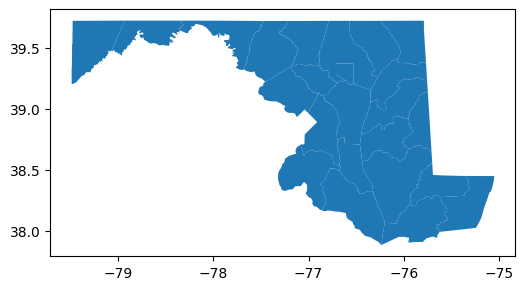

In [5]:
# plot polygons
df.plot(figsize=(6,6))
plt.show()

In [6]:
# get coordinate reference
df.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [7]:
# Use WGS 84 (epsg:4326) as the geographic coordinate system
# translation: change coordinate reference from epsg:4326 to 
# longitudal and latitudinal units
df = df.to_crs(epsg=4326)
print(df.crs)
df.head()

EPSG:4326


,COUNTY,DISTRICT,TSD_ID,OBJECTID_1,COUNTY_FIP,COUNTYNUM,ShapeSTArea,ShapeSTLength,geometry
0,Garrett,6,4,1,23,11,2.865888e+09,269160.906618,"POLYGON ((-78.92842 39.72277, -79.47676 39.721..."
1,Washington,6,1060,2,43,21,2.041340e+09,375108.707731,"POLYGON ((-78.33777 39.72256, -78.33780 39.722..."
2,Dorchester,1,5,3,19,9,4.162348e+09,321145.407961,"POLYGON ((-75.71224 38.64172, -75.71230 38.641..."
3,Worcester,1,2,4,47,23,2.456936e+09,269799.871561,"POLYGON ((-75.06149 38.39055, -75.06125 38.391..."
4,Frederick,7,24,5,21,10,2.905713e+09,270091.287672,"POLYGON ((-77.35263 39.71988, -77.46917 39.719..."


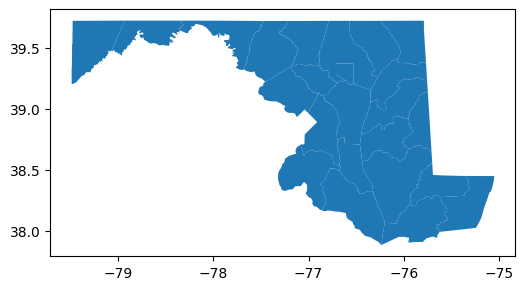

In [8]:
df.plot(figsize=(6,6))
plt.show()

In [9]:
# create folium map object
MD = folium.Map(location=[39.0458, -76.6413], zoom_start=7, tiles='CartoDB positron')
MD

In [10]:
# overlay polygons on MD map
for _, r in df.iterrows():
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j, style_function=lambda x:{'fillColor': 'green'})
    folium.Popup(r['COUNTY']).add_to(geo_j)
    geo_j.add_to(MD)
    
MD

In [11]:
# get coordinate reference
crit_df.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [12]:
# change cooridinate reference to longitude and latitude
crit_df = crit_df.to_crs(epsg=4326)
print(crit_df.crs)
crit_df.head()

EPSG:4326


,OBJECTID,Type,CritArea,WebLink,Location,ShapeSTArea,ShapeSTLength,geometry
0,8046,RCA,Resource Conservation Area,https://dnr.maryland.gov/criticalarea,Caroline County,1545.234375,444.906937,"POLYGON ((-75.93933 38.67836, -75.93938 38.678..."
1,8047,RCA,Resource Conservation Area,https://dnr.maryland.gov/criticalarea,Caroline County,3024.964844,525.943314,"POLYGON ((-75.93988 38.67881, -75.93989 38.678..."
2,8048,RCA,Resource Conservation Area,https://dnr.maryland.gov/criticalarea,Caroline County,466.593750,153.285641,"POLYGON ((-75.94928 38.68052, -75.94929 38.680..."
3,8049,RCA,Resource Conservation Area,https://dnr.maryland.gov/criticalarea,Caroline County,312.007812,116.055152,"POLYGON ((-75.94964 38.68072, -75.94970 38.680..."
4,8050,RCA,Resource Conservation Area,https://dnr.maryland.gov/criticalarea,Caroline County,420.113281,88.920263,"POLYGON ((-75.94645 38.68085, -75.94646 38.680..."


In [13]:
# overlay polygons for critical areas
for _, r in crit_df.iterrows():
    crit_sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    crit_geo_j = crit_sim_geo.to_json()
    crit_geo_j = folium.GeoJson(data=crit_geo_j, style_function=lambda x:{'fillColor': 'red'})
    folium.Popup(r['Location']).add_to(crit_geo_j)
    crit_geo_j.add_to(MD)
    
MD